In [1]:
import torch, torchvision, os, PIL, pdb
from torch import nn
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torch import nn

In [2]:
def show(tensor, num=25, wandbactive=0, name=''):
    data = tensor.detach().cpu()
    grid = make_grid(data[:num], nrow=5).permute(1,2,0)
    plt.imshow(grid.clip(0,1))
    plt.axis(False)
    plt.show()

In [3]:
n_epochs= 100
batch_size=64
lr=1e-4
z_dim=200
device = "cuda"
cur_step=0
crit_cycles=2
gen_losses=[]
crit_losses=[]
show_step=35
save_step=35


In [4]:
def gen_noise(num, z_dim, device='cuda'):
    return torch.randn(num, z_dim, device=device) # 128 x 200


In [5]:
# generator model
# https://medium.com/@ideami

class Generator(nn.Module):
    def __init__(self, z_dim=64, d_dim=16):
        super(Generator, self).__init__()
        self.z_dim=z_dim
        self.gen = nn.Sequential(
            nn.ConvTranspose2d(z_dim, d_dim * 32, 4, 1, 0), 
            nn.BatchNorm2d(d_dim*32),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*32, d_dim*16, 4, 2, 1),
            nn.BatchNorm2d(d_dim*16),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*16, d_dim*8, 4, 2, 1),
            nn.BatchNorm2d(d_dim*8),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*8, d_dim*4, 4, 2, 1),
            nn.BatchNorm2d(d_dim*4),
            nn.ReLU(True),            

            nn.ConvTranspose2d(d_dim*4, d_dim*2, 4, 2, 1),
            nn.BatchNorm2d(d_dim*2),
            nn.ReLU(True),            

            nn.ConvTranspose2d(d_dim*2, 3, 4, 2, 1),
            nn.Tanh() )
    
    def forward(self, noise):
        x=noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

In [6]:
## critic model

class Critic(nn.Module):
    def __init__(self, d_dim=16):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            nn.Conv2d(3, d_dim, 4, 2, 1),
            nn.InstanceNorm2d(d_dim), 
            nn.LeakyReLU(0.2),

            nn.Conv2d(d_dim, d_dim*2, 4, 2, 1),
            nn.InstanceNorm2d(d_dim*2), 
            nn.LeakyReLU(0.2),

            nn.Conv2d(d_dim*2, d_dim*4, 4, 2, 1), 
            nn.InstanceNorm2d(d_dim*4), 
            nn.LeakyReLU(0.2),

            nn.Conv2d(d_dim*4, d_dim*8, 4, 2, 1),
            nn.InstanceNorm2d(d_dim*8), 
            nn.LeakyReLU(0.2),

            nn.Conv2d(d_dim*8, d_dim*16, 4, 2, 1),
            nn.InstanceNorm2d(d_dim*16), 
            nn.LeakyReLU(0.2),

            nn.Conv2d(d_dim*16, 1, 4, 1, 0),
    )
        
    def forward(self, image):
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred),-1)
  

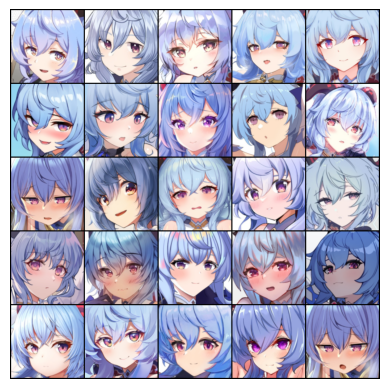

In [7]:
class Dataset(Dataset):
  def __init__(self, path, size=128, lim=10000):
    self.sizes=[size, size]
    items, labels=[],[]

    for data in os.listdir(path)[:lim]:
      #path: './data/celeba/img_align_celeba'
      #data: '114568.jpg
      item = os.path.join(path,data)
      items.append(item)
      labels.append(data)
    self.items=items
    self.labels=labels


  def __len__(self):
    return len(self.items)

  def __getitem__(self,idx):
    data = PIL.Image.open(self.items[idx]).convert('RGB') # (178,218)
    data = np.asarray(torchvision.transforms.Resize(self.sizes)(data)) # 128 x 128 x 3
    data = np.transpose(data, (2,0,1)).astype(np.float32, copy=False) # 3 x 128 x 128 # from 0 to 255
    data = torch.from_numpy(data).div(255) # from 0 to 1
    return data, self.labels[idx]


data_path="/kaggle/input/ganyu-genshin-impact-anime-faces-gan-training/ganyu/ganyu-final"
ds = Dataset(data_path, size=128, lim=10000)
dataloader = DataLoader(ds, batch_size=batch_size, shuffle=True)
gen = Generator(z_dim).to(device)
crit = Critic().to(device)

x,y=next(iter(dataloader))
show(x)


In [8]:
!git clone https://github.com/kyegomez/Sophia
%cd Sophia
from Sophia import SophiaG
from IPython.display import clear_output
clear_output()

In [9]:
gen_opt = SophiaG(gen.parameters(), lr=lr, betas=(0.5,0.9))
crit_opt= SophiaG(crit.parameters(), lr=lr, betas=(0.5,0.9))

In [10]:


def get_gp(real, fake, crit, alpha, gamma=10):
    mix_images = real * alpha + fake * (1-alpha)
    mix_scores = crit(mix_images)
    gradient = torch.autograd.grad(
      inputs = mix_images,
      outputs = mix_scores,
      grad_outputs=torch.ones_like(mix_scores),
      retain_graph=True,
      create_graph=True)[0]

    gradient = gradient.view(len(gradient), -1)
    gradient_norm = gradient.norm(2, dim=1) 
    gp = gamma * ((gradient_norm-1)**2).mean()
    return gp



  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

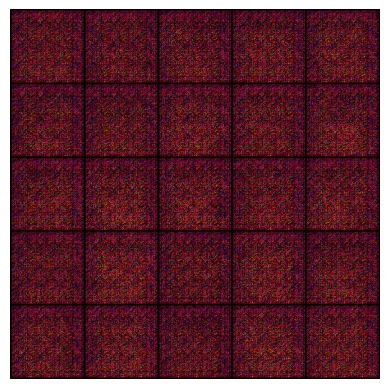

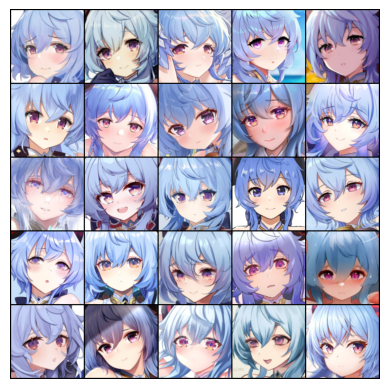

Epoch: 2: Step 35: Generator loss: 2.2281889352947473, critic loss: -0.7628513208457401


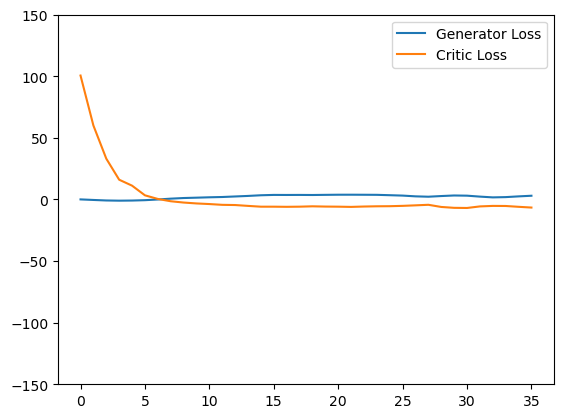

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

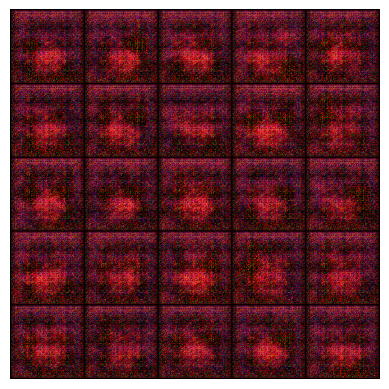

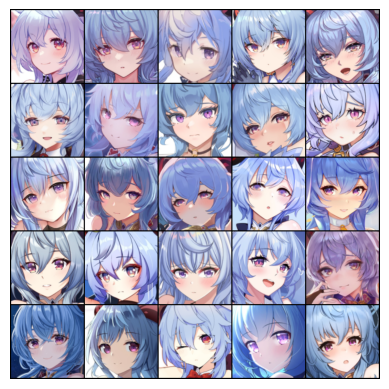

Epoch: 5: Step 70: Generator loss: 1.7528465143271854, critic loss: -6.036484922681536


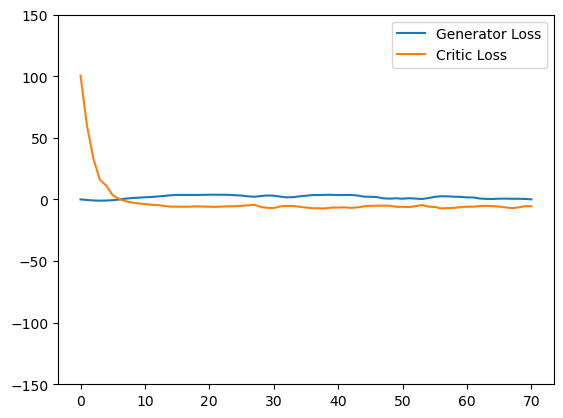

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

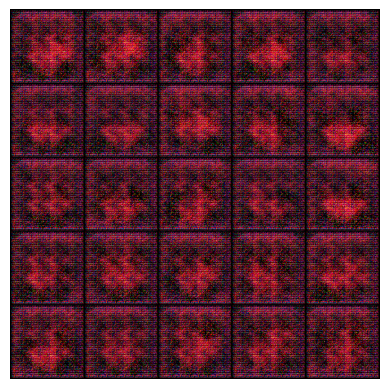

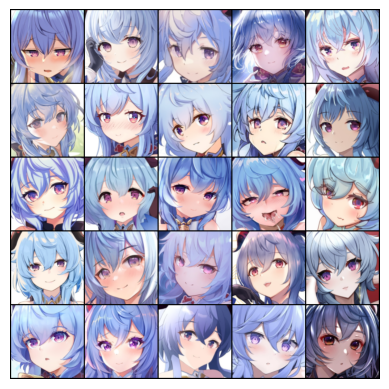

Epoch: 7: Step 105: Generator loss: 0.9272301224725586, critic loss: -7.694711807795933


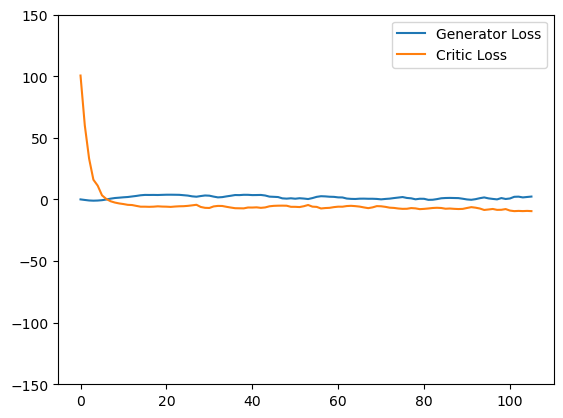

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

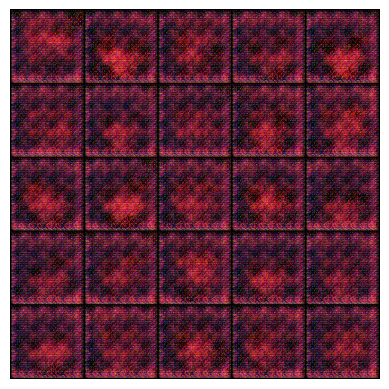

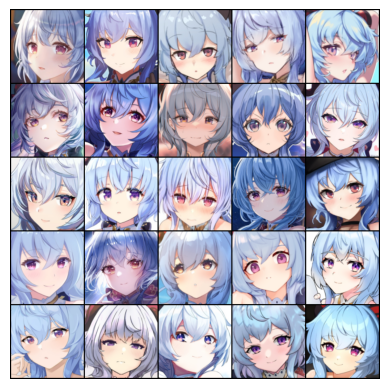

Epoch: 10: Step 140: Generator loss: 2.2907576084136965, critic loss: -11.506980691637311


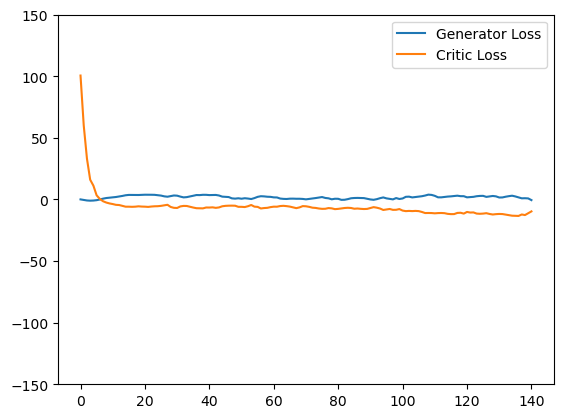

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

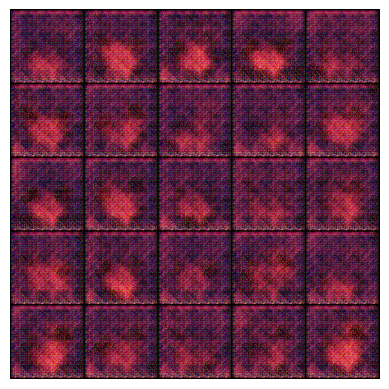

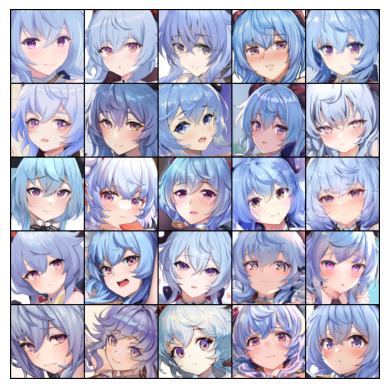

Epoch: 12: Step 175: Generator loss: 2.532582115275519, critic loss: -14.719672693525041


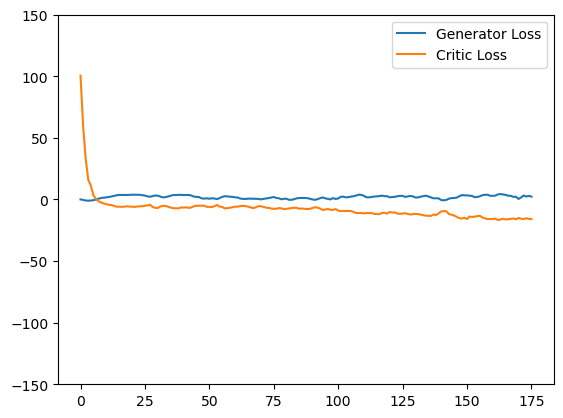

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

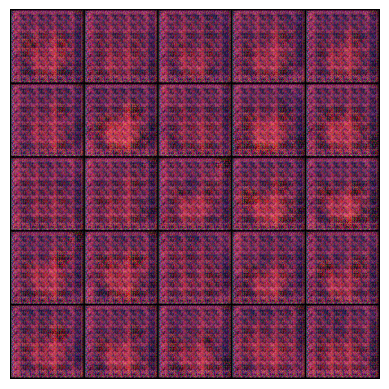

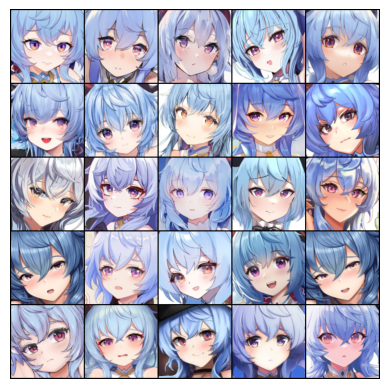

Epoch: 15: Step 210: Generator loss: 1.7112319435392107, critic loss: -14.291772719791958


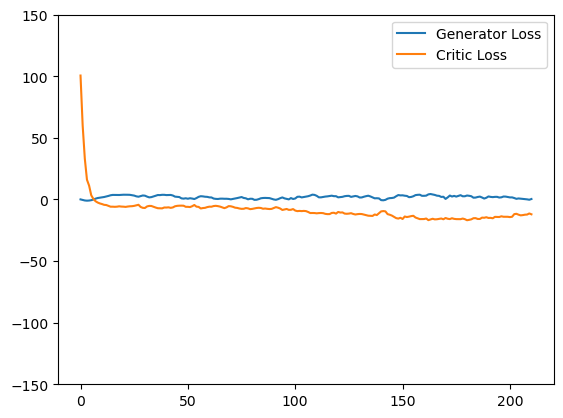

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

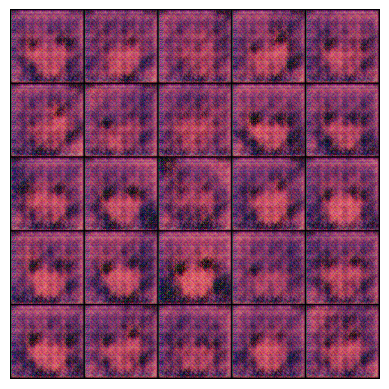

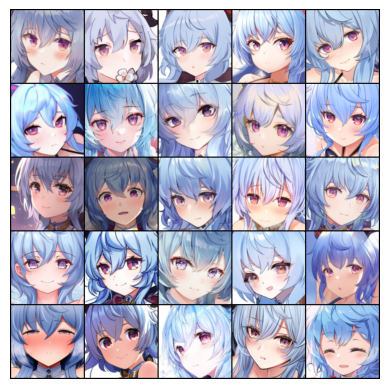

Epoch: 17: Step 245: Generator loss: 1.0113182138585086, critic loss: -13.09227248600551


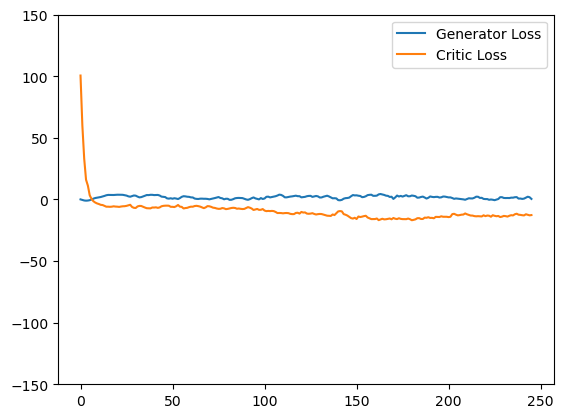

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

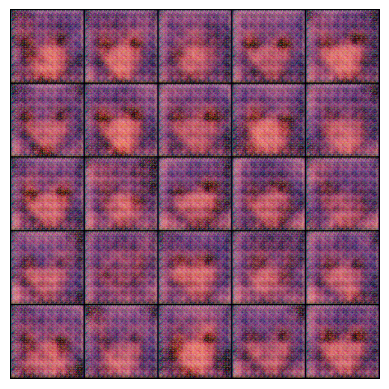

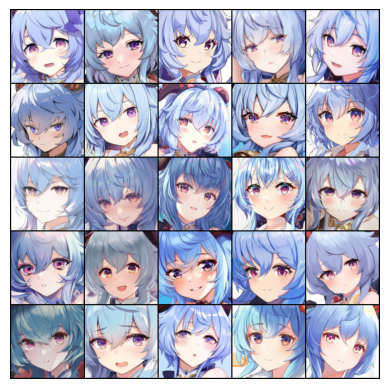

Epoch: 20: Step 280: Generator loss: 1.4473611797605241, critic loss: -13.655621446881975


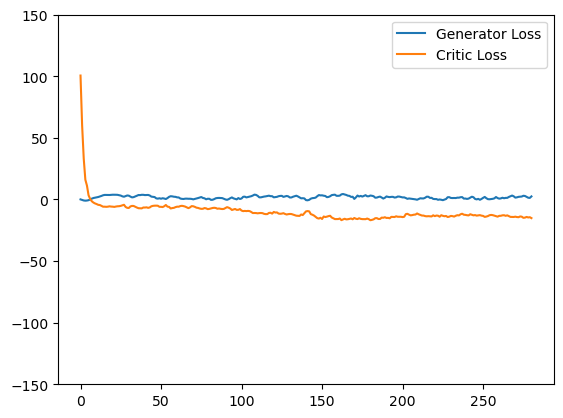

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

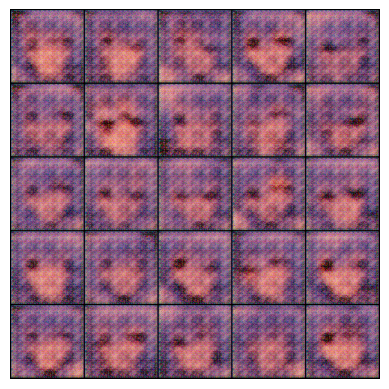

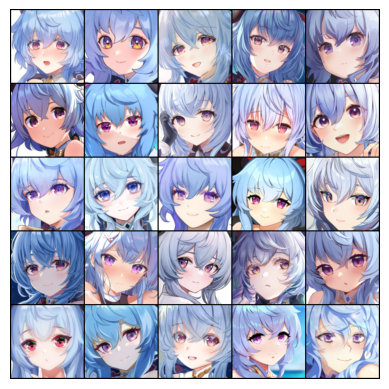

Epoch: 22: Step 315: Generator loss: 3.796410598073687, critic loss: -16.604247433798655


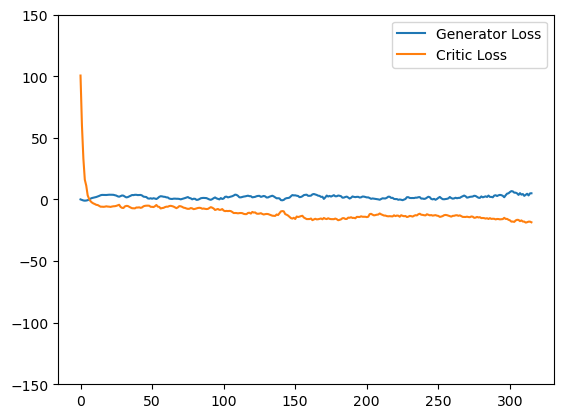

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

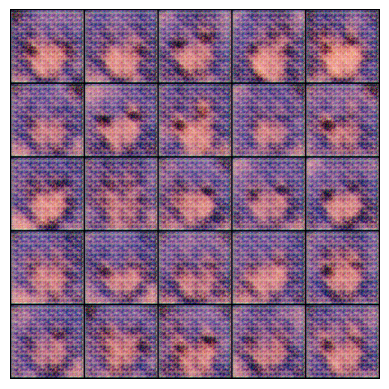

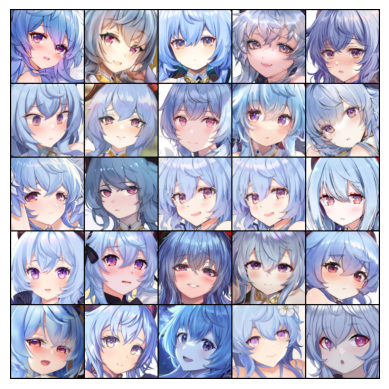

Epoch: 25: Step 350: Generator loss: 4.579405587060111, critic loss: -17.626155294690815


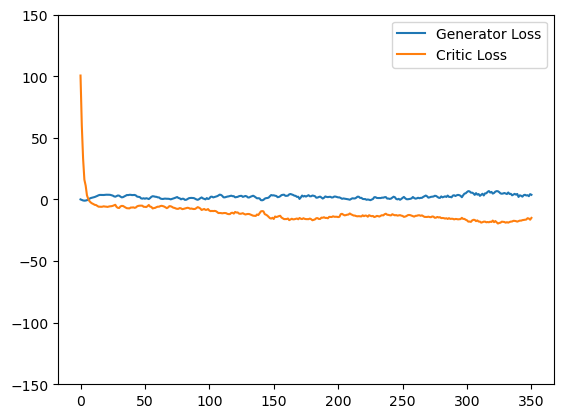

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

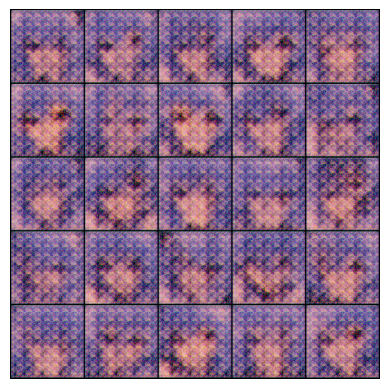

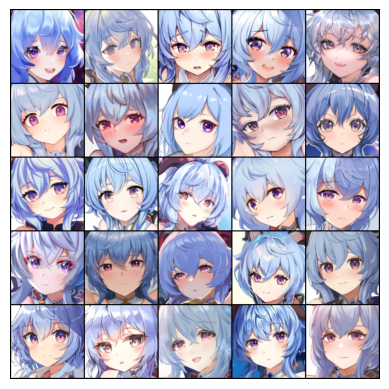

Epoch: 27: Step 385: Generator loss: 2.599343261548451, critic loss: -13.560713386535644


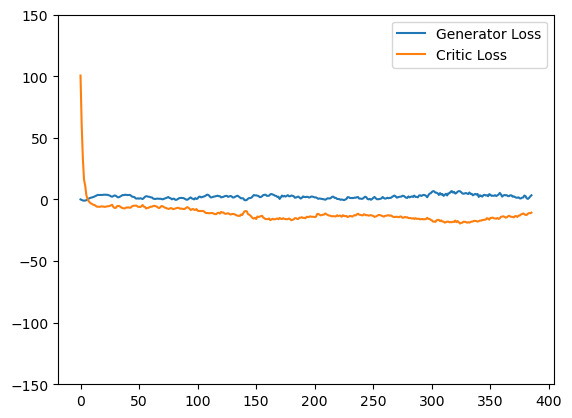

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

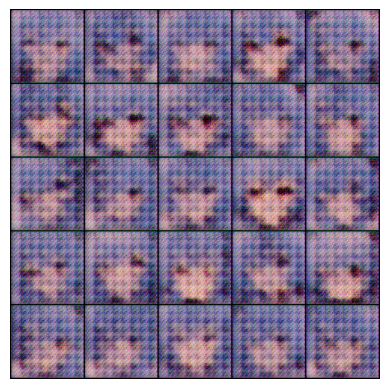

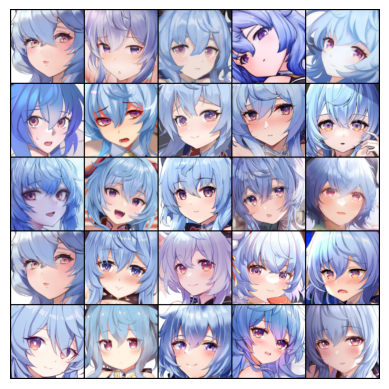

Epoch: 30: Step 420: Generator loss: 1.316643683399473, critic loss: -9.503731734412057


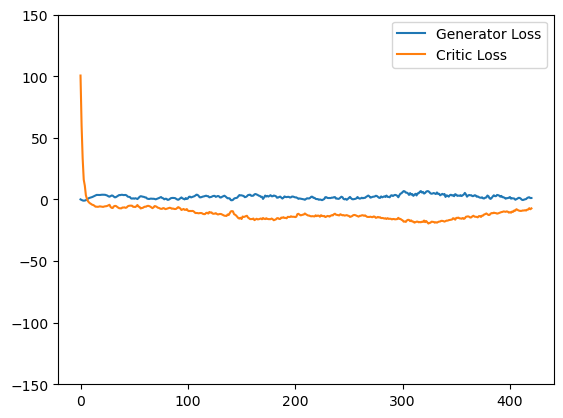

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

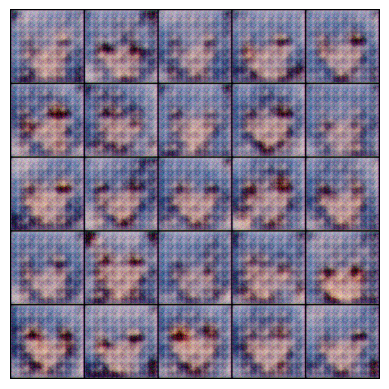

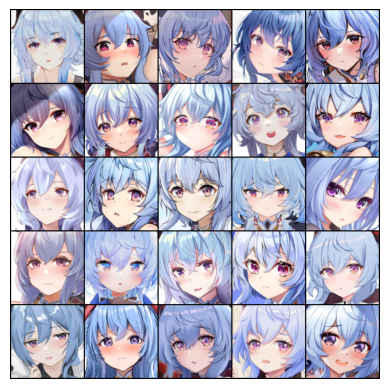

Epoch: 32: Step 455: Generator loss: -0.31582481626953396, critic loss: -7.000421047210693


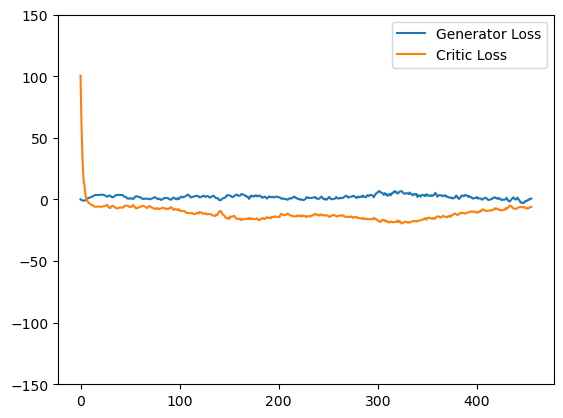

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

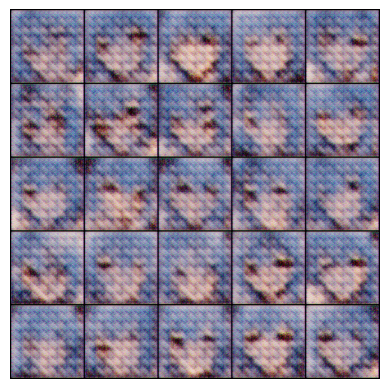

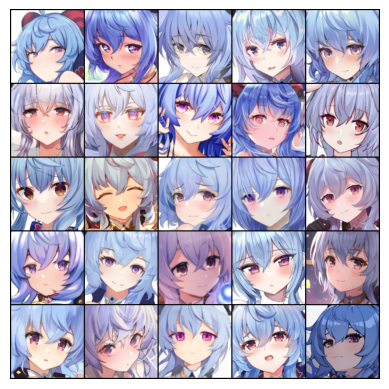

Epoch: 35: Step 490: Generator loss: -0.455984933248588, critic loss: -5.967293316977365


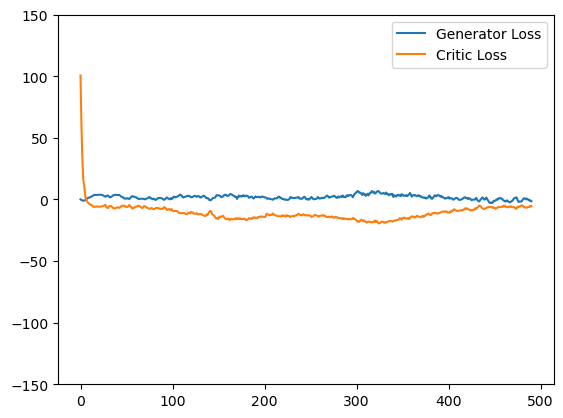

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

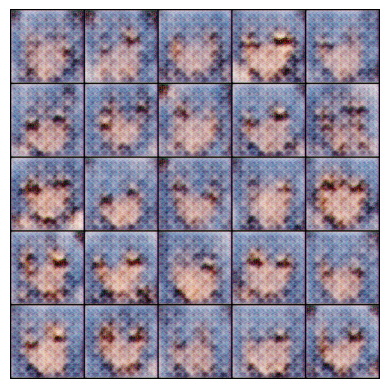

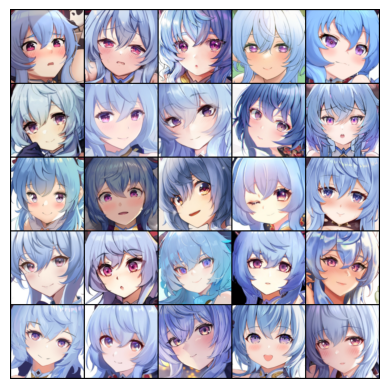

Epoch: 37: Step 525: Generator loss: -0.5009582491857665, critic loss: -6.389623471668789


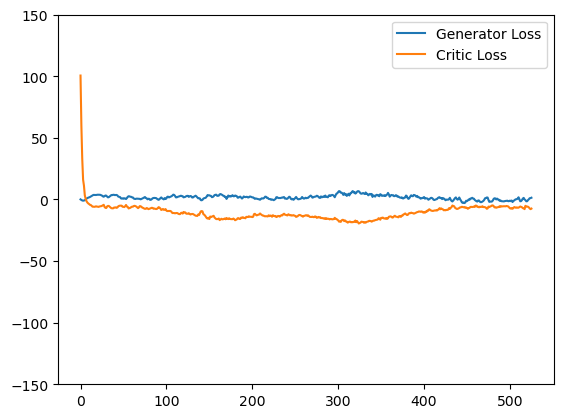

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

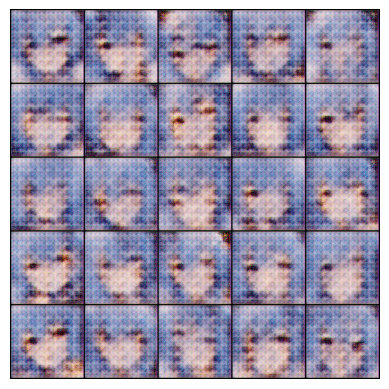

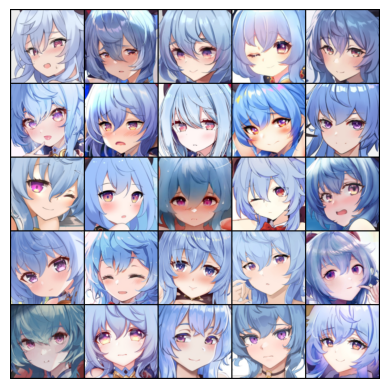

Epoch: 40: Step 560: Generator loss: 0.257285955122539, critic loss: -7.3498622485569545


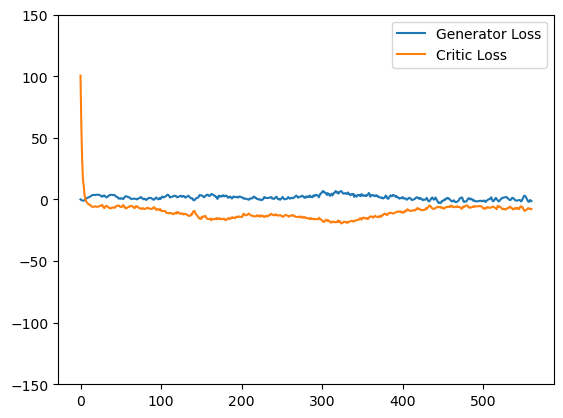

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

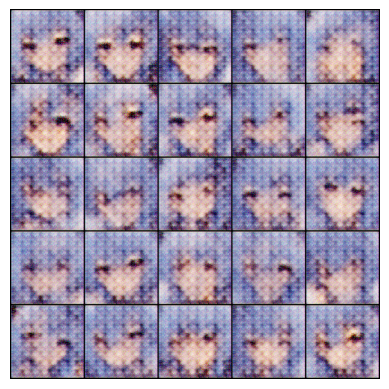

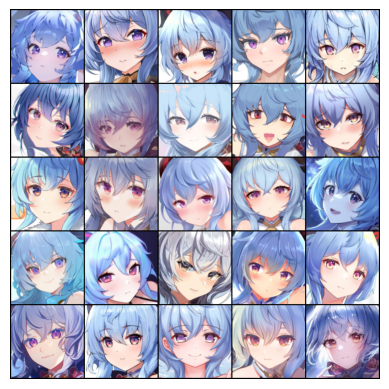

Epoch: 42: Step 595: Generator loss: -0.004710773059300014, critic loss: -7.598731701714652


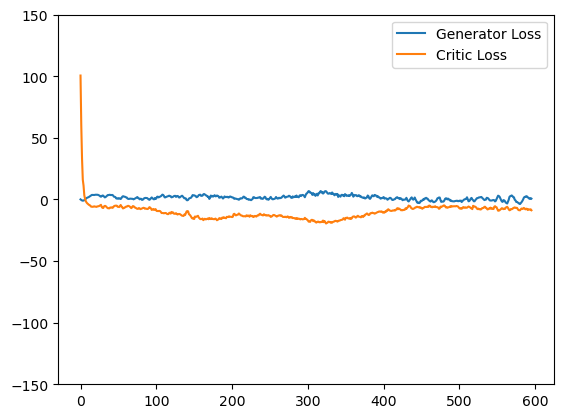

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

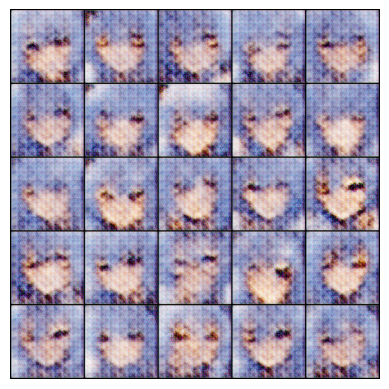

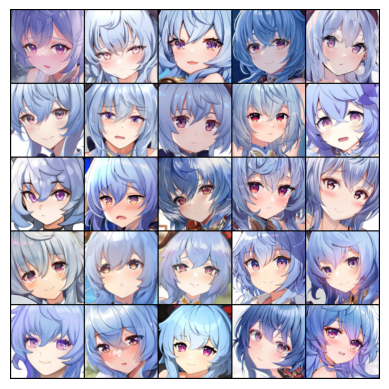

Epoch: 45: Step 630: Generator loss: 0.251602343576295, critic loss: -7.736314576012748


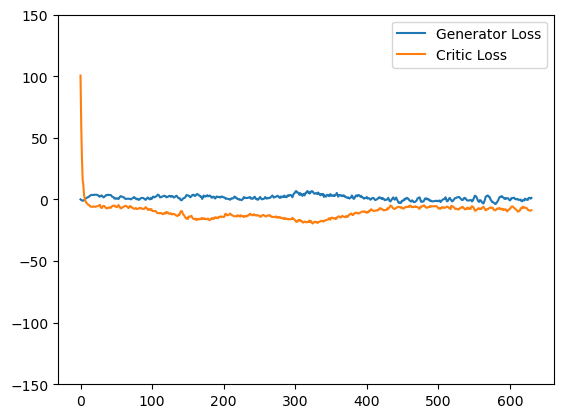

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

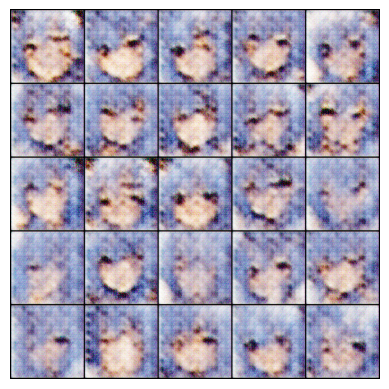

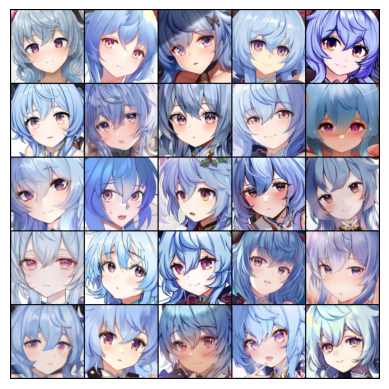

Epoch: 47: Step 665: Generator loss: 0.4671420088836125, critic loss: -7.98370909009661


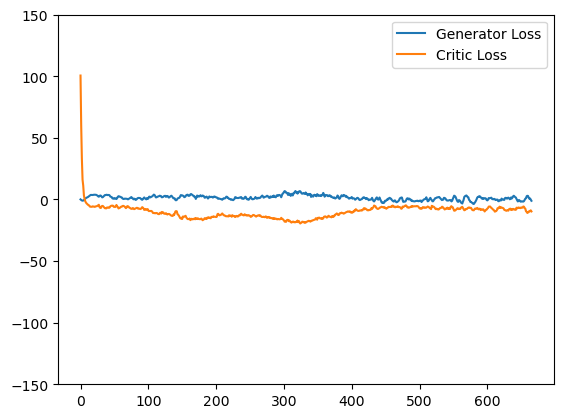

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

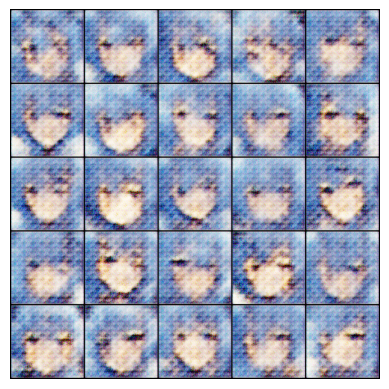

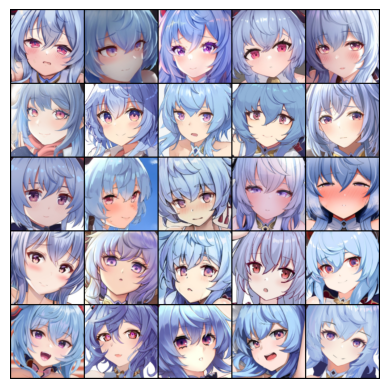

Epoch: 50: Step 700: Generator loss: -0.004087849174227033, critic loss: -7.97840016910008


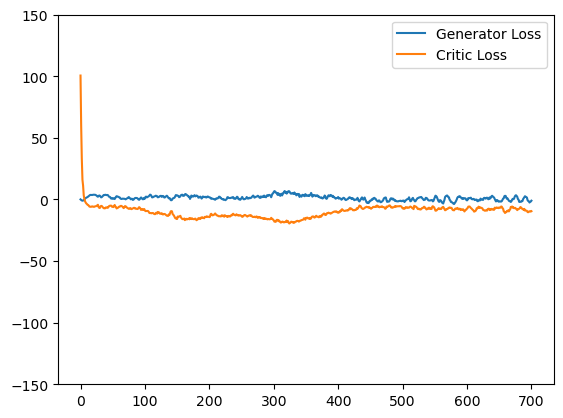

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

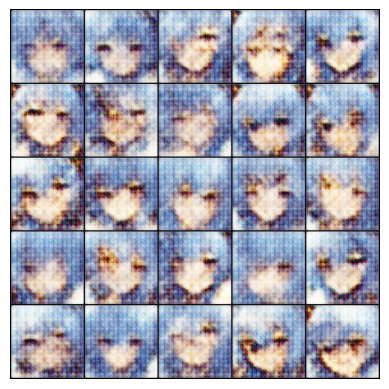

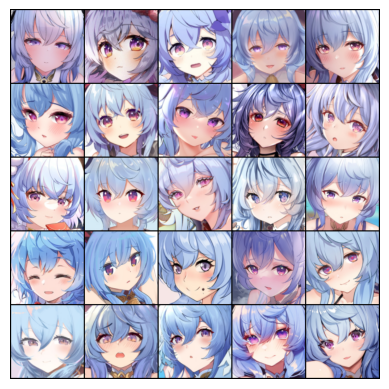

Epoch: 52: Step 735: Generator loss: -0.23964985311031342, critic loss: -8.129647084644862


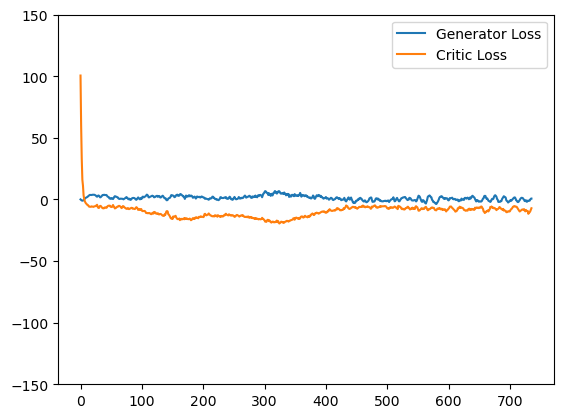

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

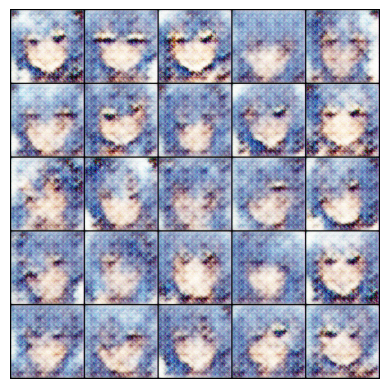

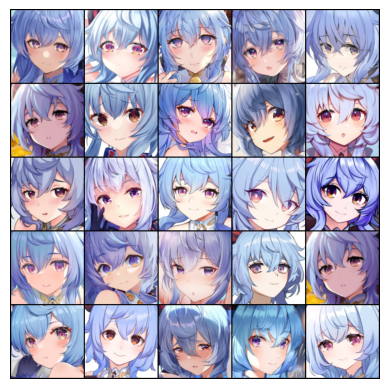

Epoch: 55: Step 770: Generator loss: 0.6845561755555016, critic loss: -7.724500751495361


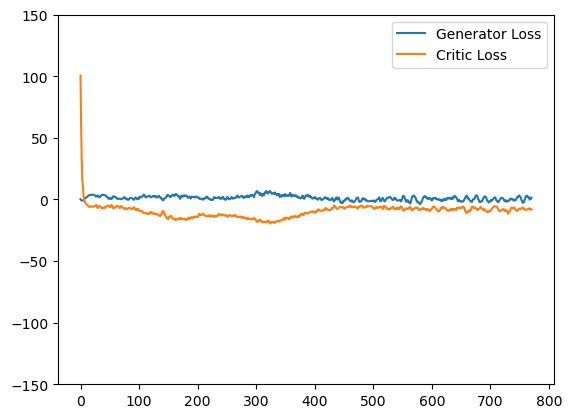

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

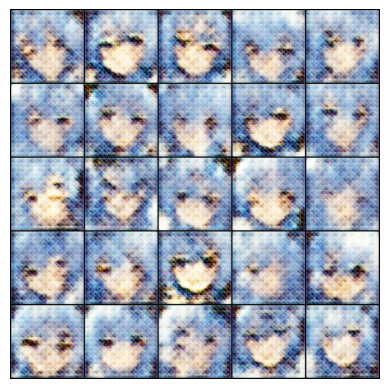

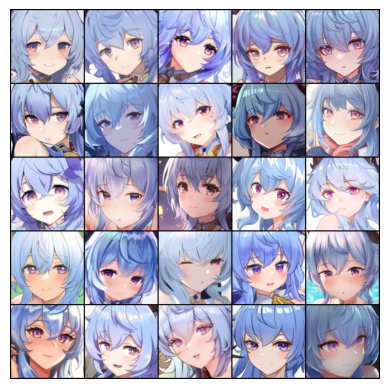

Epoch: 57: Step 805: Generator loss: -0.024620548635721207, critic loss: -8.28430049078805


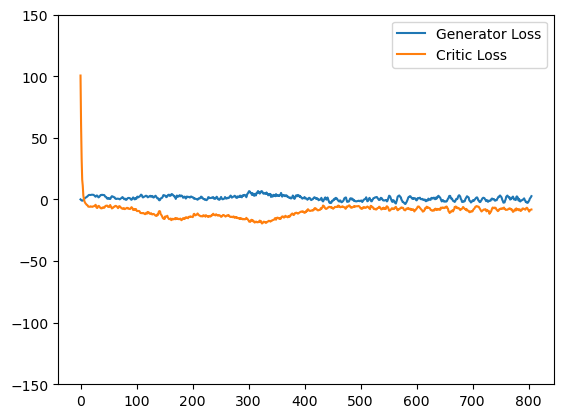

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

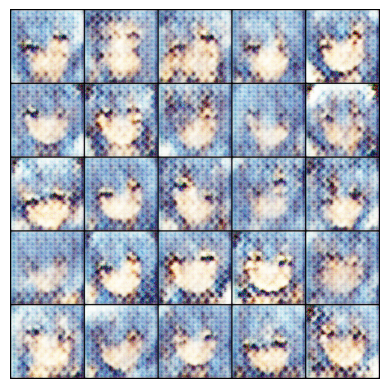

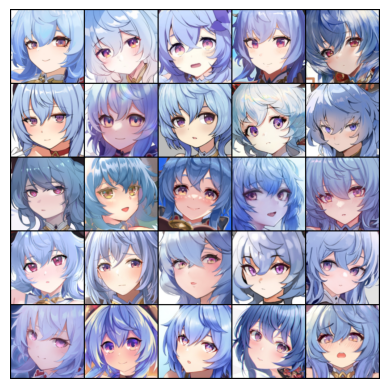

Epoch: 60: Step 840: Generator loss: -0.43161235845514706, critic loss: -8.592137936183384


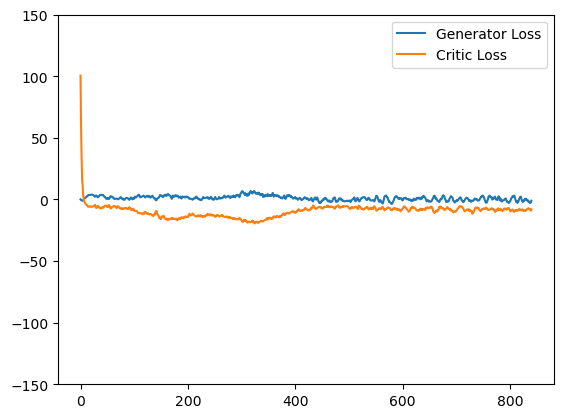

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

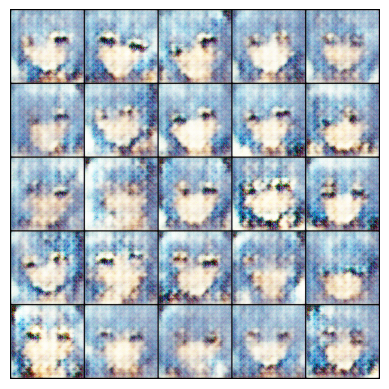

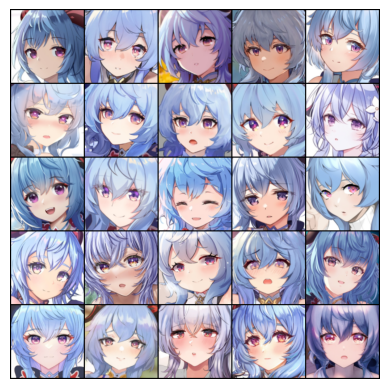

Epoch: 62: Step 875: Generator loss: -0.40531853011676244, critic loss: -8.55624270439148


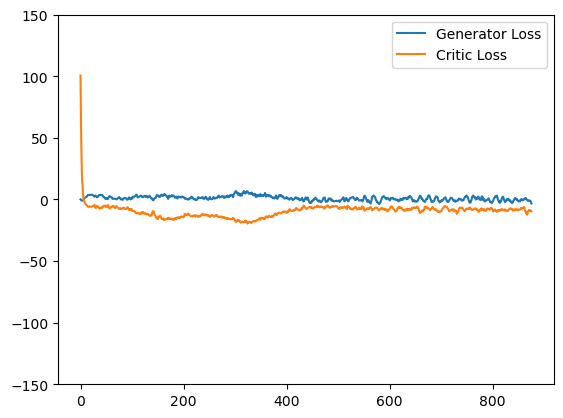

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

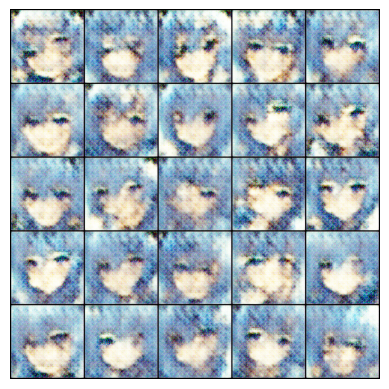

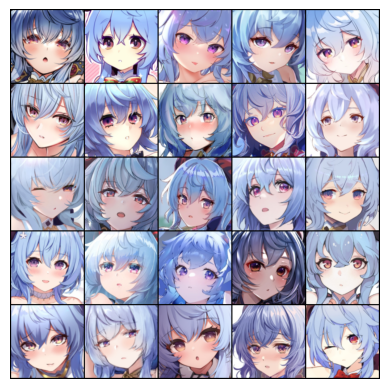

Epoch: 65: Step 910: Generator loss: -1.282344601409776, critic loss: -8.402735437665667


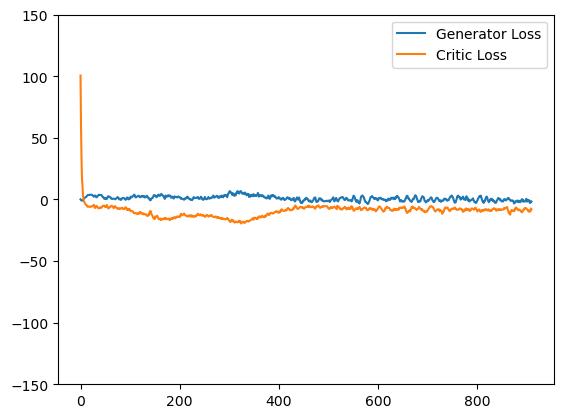

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

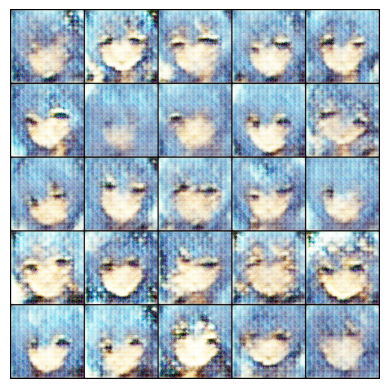

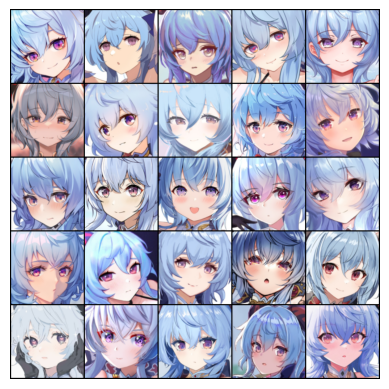

Epoch: 67: Step 945: Generator loss: -1.530578851699829, critic loss: -8.683204139981951


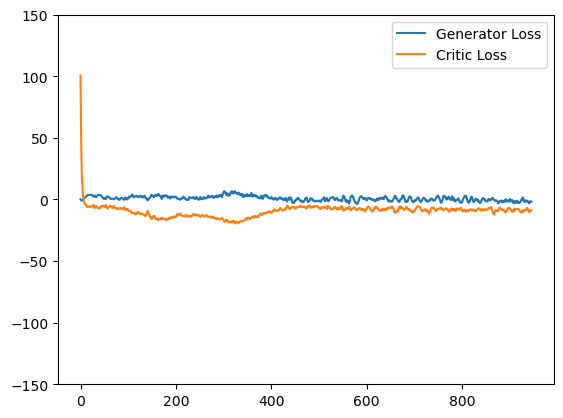

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

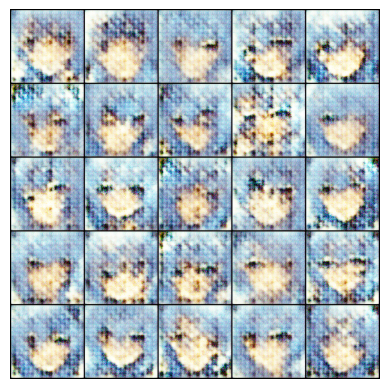

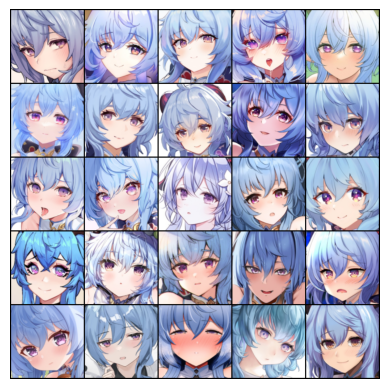

Epoch: 70: Step 980: Generator loss: -2.0082327311592443, critic loss: -8.496328163146973


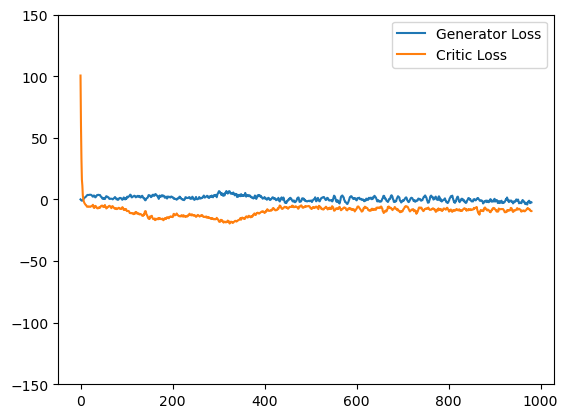

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

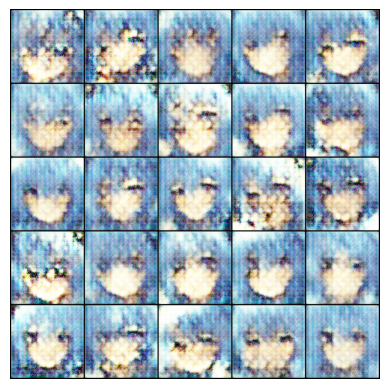

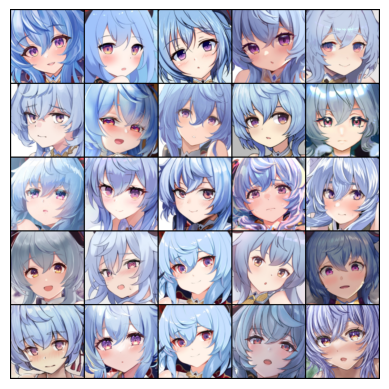

Epoch: 72: Step 1015: Generator loss: -3.0569365228925434, critic loss: -8.569694907324655


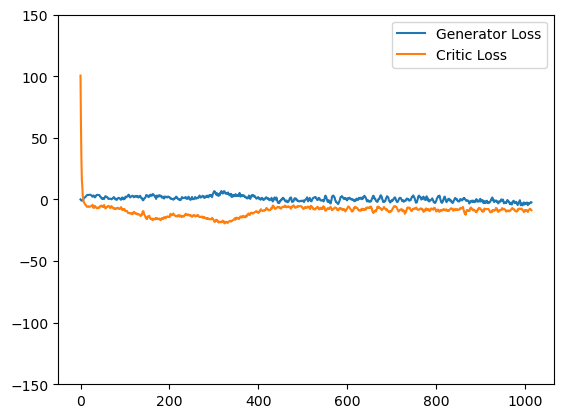

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

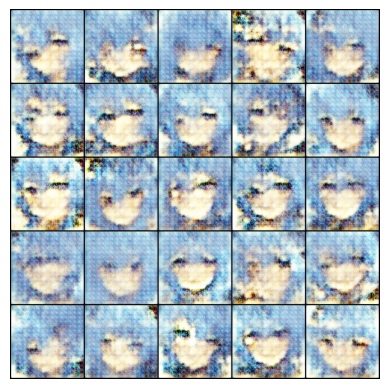

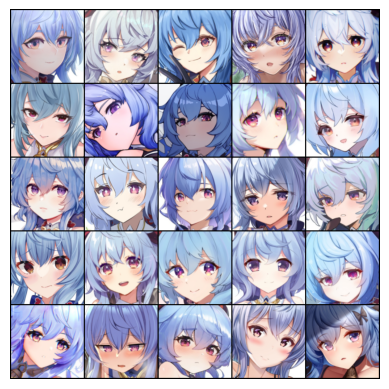

Epoch: 75: Step 1050: Generator loss: -2.2082457282713484, critic loss: -8.877262783050536


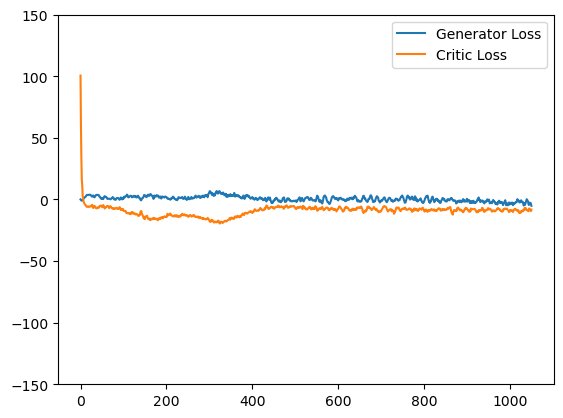

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

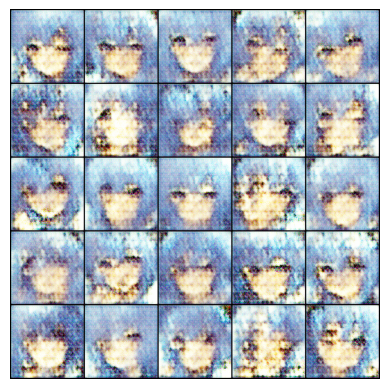

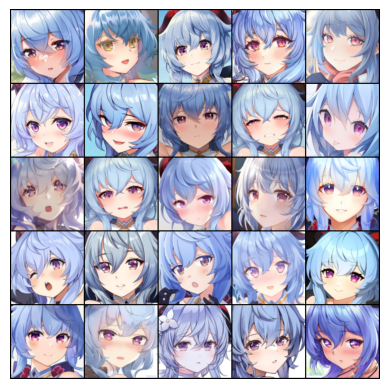

Epoch: 77: Step 1085: Generator loss: -3.5371170657021658, critic loss: -8.300238398143224


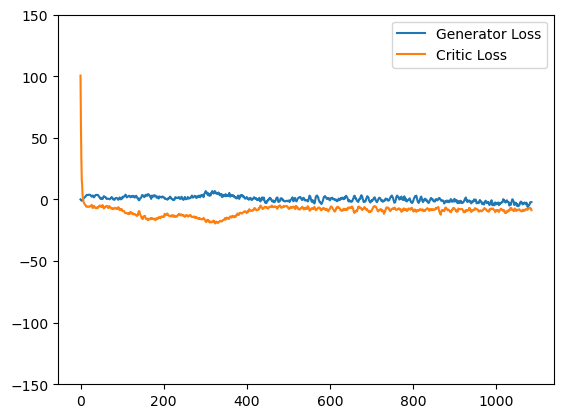

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

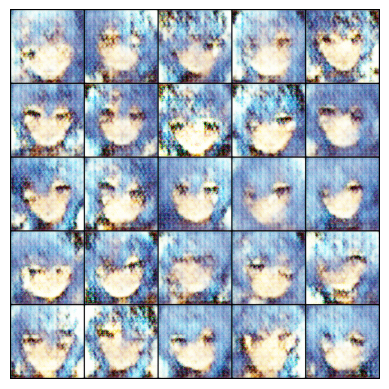

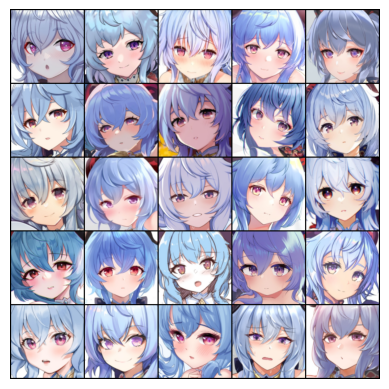

Epoch: 80: Step 1120: Generator loss: -3.7747564452035087, critic loss: -8.196988214765277


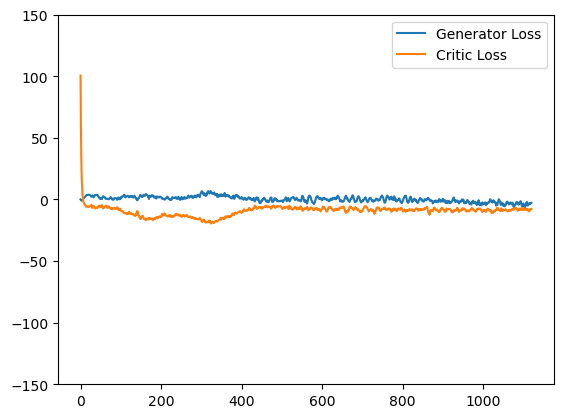

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

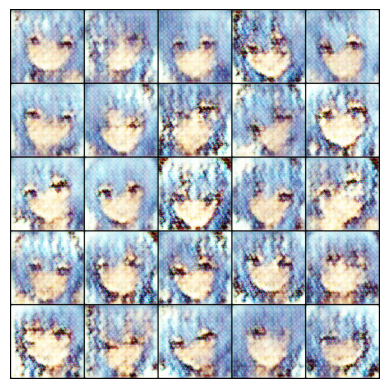

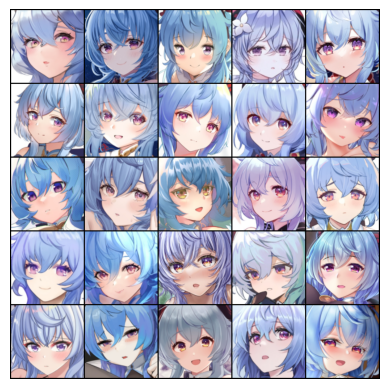

Epoch: 82: Step 1155: Generator loss: -4.171865027291434, critic loss: -7.865116568974086


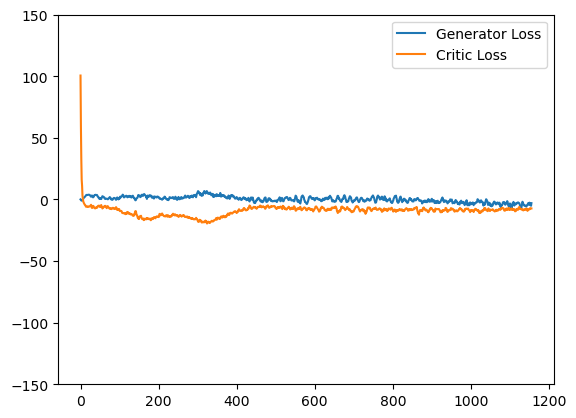

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

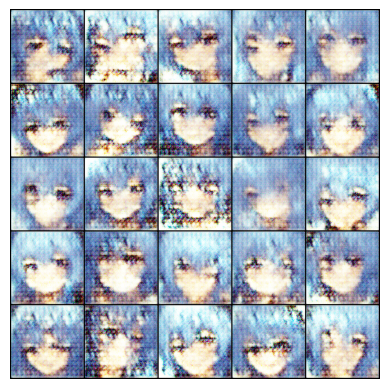

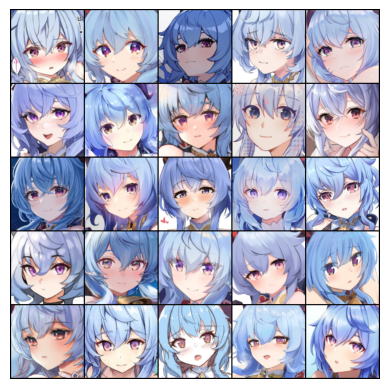

Epoch: 85: Step 1190: Generator loss: -3.6106814929417204, critic loss: -8.340877710069929


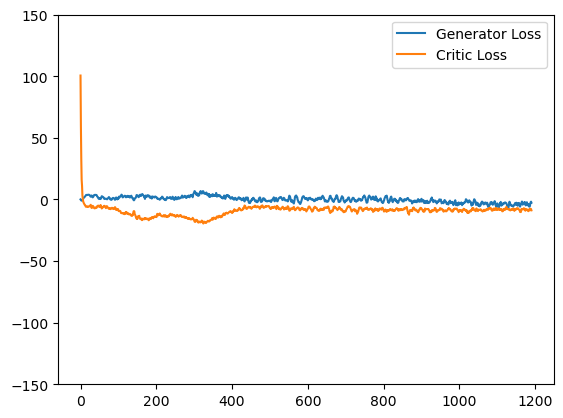

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

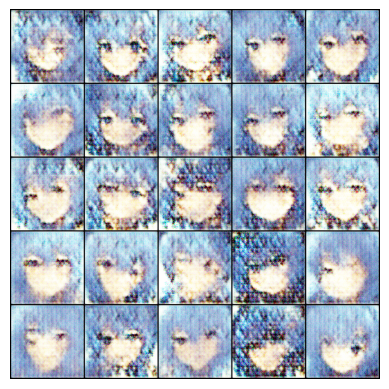

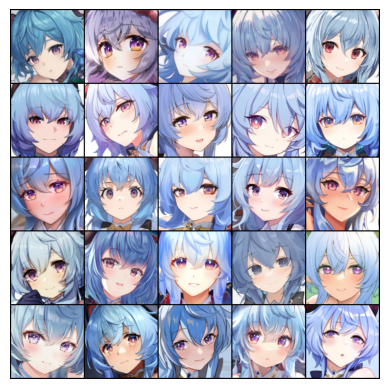

Epoch: 87: Step 1225: Generator loss: -4.627018996647426, critic loss: -7.990539578029088


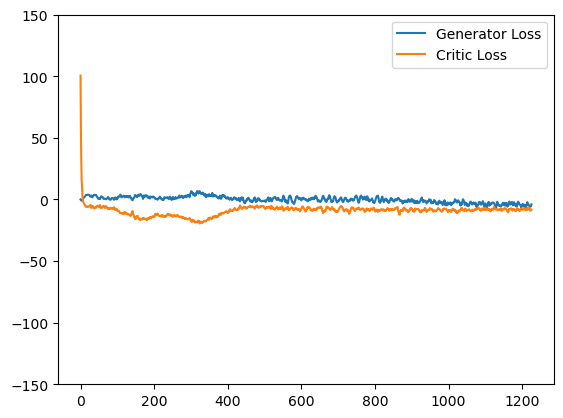

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

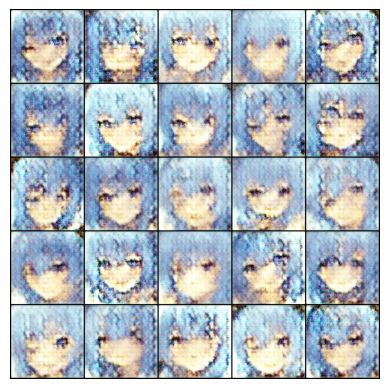

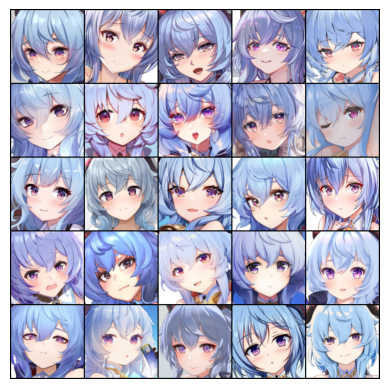

Epoch: 90: Step 1260: Generator loss: -4.79189966406141, critic loss: -7.831737722669329


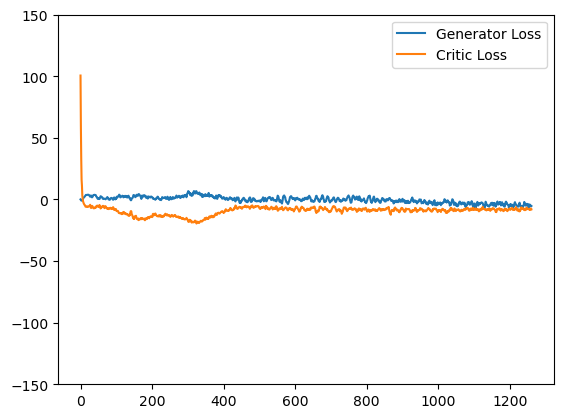

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

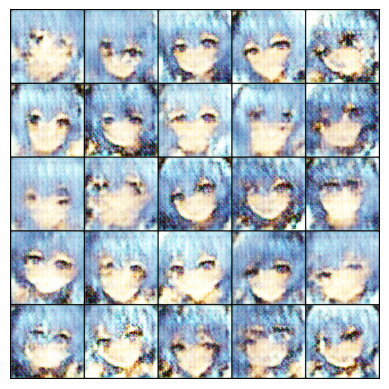

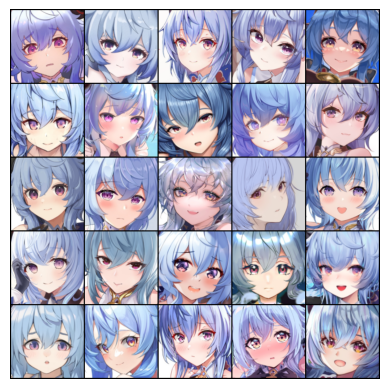

Epoch: 92: Step 1295: Generator loss: -4.95119641167777, critic loss: -7.795455230985369


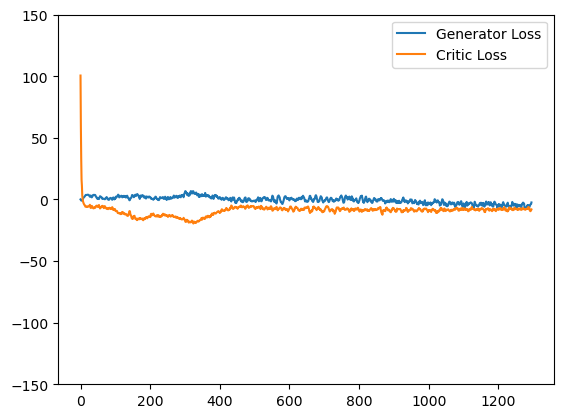

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

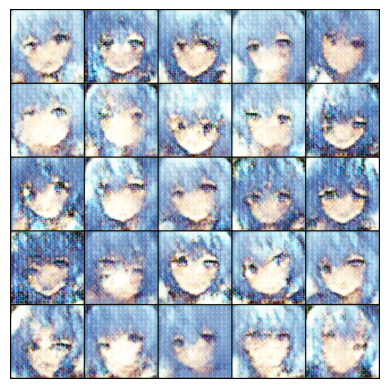

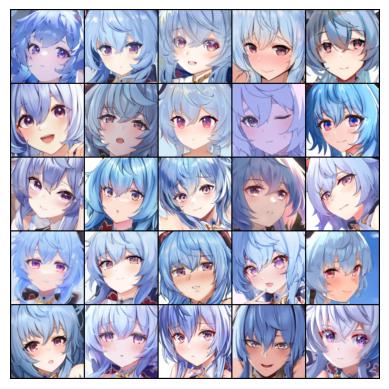

Epoch: 95: Step 1330: Generator loss: -5.1775373935699465, critic loss: -7.839048263004848


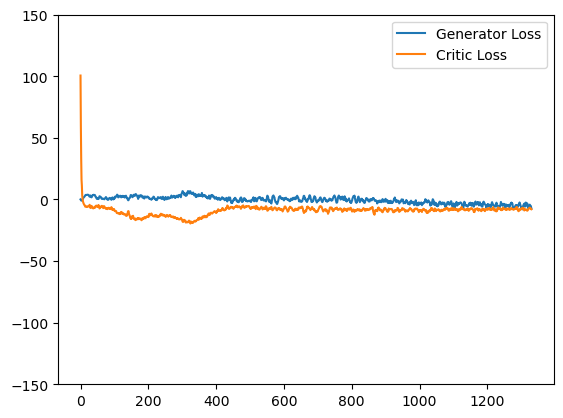

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

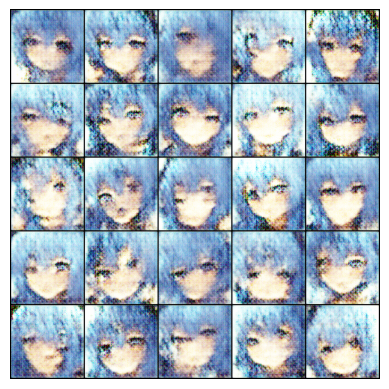

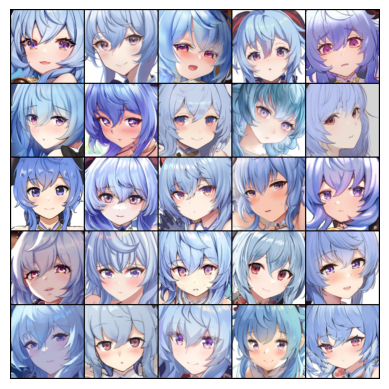

Epoch: 97: Step 1365: Generator loss: -5.295865889957973, critic loss: -7.7816798278263635


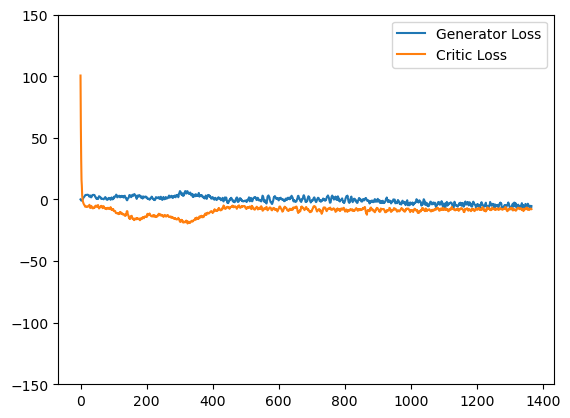

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

In [11]:
for epoch in range(n_epochs):
    for real, _ in tqdm(dataloader):
        cur_bs= len(real) 
        real=real.to(device)
        
        mean_crit_loss = 0
        for _ in range(crit_cycles):
            crit_opt.zero_grad()
            noise=gen_noise(cur_bs, z_dim)
            fake = gen(noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            alpha=torch.rand(len(real),1,1,1,device=device, requires_grad=True) # 128 x 1 x 1 x 1
            gp = get_gp(real, fake.detach(), crit, alpha)
            crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + gp
            mean_crit_loss+=crit_loss.item() / crit_cycles
            crit_loss.backward(retain_graph=True)
            crit_opt.step()
            
        crit_losses+=[mean_crit_loss]
        gen_opt.zero_grad()
        noise = gen_noise(cur_bs, z_dim)
        fake = gen(noise)
        crit_fake_pred = crit(fake)
        gen_loss = -crit_fake_pred.mean()
        gen_loss.backward()
        
        gen_opt.step()
        
        gen_losses+=[gen_loss.item()]
        if (cur_step % show_step == 0 and cur_step > 0):
            show(fake, name='fake')
            show(real, name='real')
            gen_mean=sum(gen_losses[-show_step:]) / show_step
            crit_mean = sum(crit_losses[-show_step:]) / show_step
            print(f"Epoch: {epoch}: Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            
            plt.plot( 
                range(len(gen_losses)),
                torch.Tensor(gen_losses),
                label="Generator Loss")
            
            plt.plot(range(len(gen_losses)),
                     torch.Tensor(crit_losses),
                     label="Critic Loss")
            
            plt.ylim(-150,150)
            plt.legend()

            
            plt.show()
    
        cur_step+=1
